# Problem 3 - Answers

First of all import packages and set the constants and discretisation. Note that the number of timesteps has been defined such that $v\frac{\delta t}{\delta x} \leq 1$

In [1]:
# imports
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as ani
from IPython.display import HTML

In [2]:
# set timesteps and constants
L = 0.610
rho = 3.09E-4
T = 56.4
v_sq = T/rho
end = 0.05
start = 0
Nx = 50
g = L/Nx
h = g/np.sqrt(v_sq)
Nt = int(round((end-start)/h))+1
t = np.linspace(start,end,Nt)
x = np.linspace(0,L,Nx)


The finite difference method approximates $f''(x)$ with $\frac{f(x-\delta x) - 2f(x) + f(x+\delta x)}{\delta x^2}$. This can be derived quite nicely by adding together Taylor series around $x + \delta x$ and $x - \delta x$, and rearraging for $f''(x)$.  

The wave equation is:

$$ \frac{d^2\psi}{dt^2} = v^2\frac{d^2\psi}{dx^2}. $$

$\frac{d^2\psi}{dx^2}$ is the 1D laplacian, so we can approximate it at point $i$ along the string according to the above method as:

$$ \frac{d^2\psi_i}{dx^2} = \frac{\psi_{i-1} - 2\psi_i + \psi_{i+1}}{g^2}, $$

as $g$ is what we are calling $\delta x$.

Implementing this in a function:

In [3]:
# new function to evaluate
def f(r,t):
    phi = r[0]
    Vphi = r[1]
    fphi = Vphi
    fVphi = []
    for idx,val in enumerate(phi):
        if idx == 0:
            fVphi.append(0)
        elif idx < len(phi)-1:
            fVphi.append(v_sq*(phi[idx-1] - 2*val + phi[idx+1])/(g**2))
        elif idx == len(phi)-1:
            fVphi.append(0)
    return np.array([fphi,fVphi])


In [4]:
# runge-kutta solver, as in question 2
def rungekutta(r,t):
    solution = [[] for n in r]
    for i in t:
        for idx,lst in enumerate(solution):
            lst.append(r[idx])
        k1 = h * f(r, i)
        k2 = h * f(r + 0.5 * k1, i + 0.5 * h)
        k3 = h * f(r + 0.5 * k2, i + 0.5 * h)
        k4 = h * f(r + k3, i + h)
        r = r + (k1 + 2 * k2 + 2 * k3 + k4) / 6
    return np.array(solution)

In [5]:
# set initial conditions
phiinit = np.zeros((len(x)))
vinit = np.copy(phiinit)
vinit[48] = 50
r = np.array([phiinit,vinit])
rsol = rungekutta(r,t)


In order to use FuncAnimation we first need to explicitly create a figure to draw our animation on. We create the figure, axes (on which we then set limits), and an empty line. The line will be used to be our string, so we create this object now for ease of reference later.

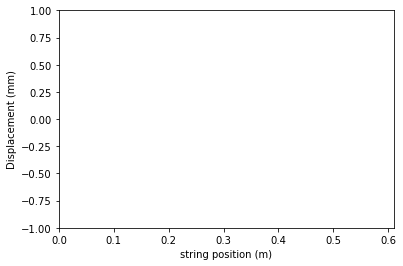

In [6]:
# initialise the figure to be animated
fig = plt.figure()
ax = plt.axes(xlim=(0, 0.610), ylim=(-1, 1),ylabel='Displacement (mm)',xlabel='string position (m)')
line, = ax.plot([], [], lw=2)


FuncAnimation creates an animation by repeatedly calling a function to generate the frames of the animation. Here we create an initial function, to reset the line to empty for the start of the animation, and then an animate function, to pick out the position of all the x points at the timestep i and plot them against the x axis (defined at the beginning).

In [7]:
# define the initial state of the line, and the update function of the animator
def init():
    line.set_data([], [])
    return line,

def animate(i):
    y = rsol[0,i,:]*1000 # structure of rsol: [x or v, time step, x step]
    line.set_data(x, y)
    return line,


Next we create an animation object with the FuncAnimation function. We ask it to make frames for the number of timesteps equivalent to the number we have calculated, and to display them with a 20 ms interval between them. Blit essentially asks the animation to only update the things that were changed in the animation function (i.e. it will only update the line, and it will leave the figure and the axes alone). We can then get the jupyter notebook to display this animation by saving it as an html5 video and embedding it in the notebook 

In [8]:
# call the animation function
animation = ani.FuncAnimation(fig,animate,init_func=init,
                               frames=Nt, interval=20, blit=True)


In [9]:
# embed the animation in the jupyter notebook
HTML(animation.to_jshtml())


Animation size has reached 20986381 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
